# Predicting Location via Indoor Positioning System 
## Analysis and Modeling in Python 
This script and subsequent notebooks are the Python conversion of the Indoor Location case study from the book, 'Data Science in R' by Nolan and Lang. http://rdatasciencecases.org/code.html <BR>
* Team: Jonathan Tan, Lance Dacy, Reannan Mcdaniel, Shawn Jung 
* Last Update: 5/14/2020 

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
#from statsmodels.distributions.empirical_distribution import ECDF
%matplotlib inline 


In [2]:
offline = pd.read_csv('./data/offline_processed.csv')

In [3]:
offline.head()

,raw_time,pos_x,pos_y,orientation,mac,signal,channel,device_type
0,2006-02-11 07:31:58.358,0.0,0.0,0.0,00:14:bf:b1:97:8a,-38.0,2437000000,3
1,2006-02-11 07:31:58.358,0.0,0.0,0.0,00:14:bf:b1:97:90,-56.0,2427000000,3
2,2006-02-11 07:31:58.358,0.0,0.0,0.0,00:0f:a3:39:e1:c0,-53.0,2462000000,3
3,2006-02-11 07:31:58.358,0.0,0.0,0.0,00:14:bf:b1:97:8d,-65.0,2442000000,3
4,2006-02-11 07:31:58.358,0.0,0.0,0.0,00:14:bf:b1:97:81,-65.0,2422000000,3


In [4]:
# Orientation data is supposed to have 8 unique values, but it seems that there are slight variation from the measurement. 
print(len(offline['orientation'].unique()))

203


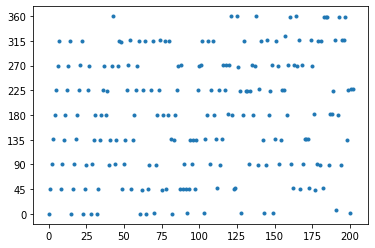

In [5]:
# The good news is, the orientation measurement remains within reasonable range of 45-degree split. We can round the value
plt.plot(offline['orientation'].unique(), marker='.', linestyle='none')
plt.yticks(np.linspace(0,360,9))
plt.show()

In [6]:
# define a function that rounds orientation value to nearest 8 slices(45 degree angle) 
def round_orientation(angle):
    refs = np.linspace(0,360,9)
    rounded_angle = refs[np.argmin(np.abs(angle - refs))]
    if rounded_angle==360:
        rounded_angle=0
    return rounded_angle


In [7]:
offline['orientation'] = offline['orientation'].apply(round_orientation)

In [8]:
# It seems that here are records from access points belong to other organization. We will filter out such cases (last three MAC addresses)

offline['mac'].value_counts()

00:0f:a3:39:e1:c0    145827
00:0f:a3:39:dd:cd    138438
00:14:bf:b1:97:8a    132713
00:14:bf:3b:c7:c6    125870
00:14:bf:b1:97:8d    121126
00:14:bf:b1:97:90    120246
00:14:bf:b1:97:81    119770
00:0f:a3:39:e0:4b     41084
00:0f:a3:39:e2:10     17750
00:04:0e:5c:23:fc       406
00:30:bd:f8:7f:c5       280
00:e0:63:82:8b:a9        94
Name: mac, dtype: int64

In [9]:
# According to the floor plan from the book, there should be 6 APs but we see 7 MAC addresses with big-enough number of observations. We will figure out what to do with them later 
legit_ap = offline['mac'].value_counts().index[0:7]
#print(legit_ap)
offline = offline[offline['mac'].isin(legit_ap)]

In [10]:
# Postion of hand-held device 
# It appears that we have reasonable amount of locations recorded as depicted in the problem statement. But let's see if the number of records are balanced 
offline.groupby(['pos_x', 'pos_y']).size()

pos_x  pos_y
0.0    0.0      5476
       1.0      5479
       2.0      5454
       3.0      5512
       4.0      5541
                ... 
32.0   8.0      5550
33.0   3.0      5415
       4.0      5473
       7.0      5501
       8.0      5340
Length: 166, dtype: int64

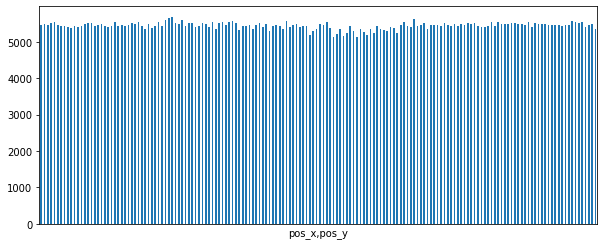

In [11]:
# Each position seems to have at least 5000 records. Looks goot to me. 
position_groups = offline.groupby(['pos_x', 'pos_y']).size()
plt.figure(figsize=(10,4))
position_groups.plot.bar()
plt.xticks([])
plt.show()

In [12]:
pos_xticks, pos_yticks = offline['pos_x'].unique(), offline['pos_y'].unique()

In [13]:
# Estimation one the AP location. 
temp_ap = offline[offline['mac'] == legit_ap[6]][['pos_x', 'pos_y', 'signal']]

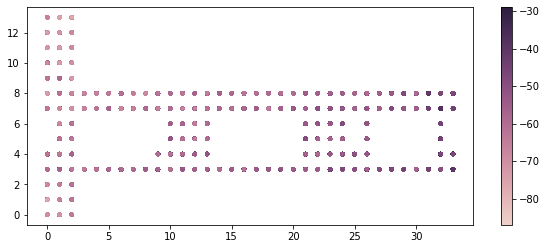

In [14]:
# From this contour-ish plot, we can see the signal gets strong around right side of the plan. 
cmap = sns.cubehelix_palette(as_cmap=True)
plt.figure(figsize=(10,4))
plt.scatter(temp_ap['pos_x'], temp_ap['pos_y'], c=temp_ap['signal'], s=10, cmap=cmap)
plt.colorbar()
plt.show()

In [15]:
# Considering the WiFi signal and distance have relationship, it makes sense that this AP could exist somewhere near (3, -29). The orignial R code re-examines this with scatter plot, but I will skip it. 
temp_ap.sort_values(by='signal', ascending=False).head(5)


,pos_x,pos_y,signal
887025,33.0,3.0,-29.0
886938,33.0,3.0,-29.0
887090,33.0,3.0,-29.0
886743,33.0,3.0,-29.0
886799,33.0,3.0,-30.0


In [16]:
# When roughly estimating AP locations by averagoing out top three signals per each MAC address, we can see the first and second MAC addresses are in similar location. When comparing to the original floor plan, it appears that these addresses belong to a same AP. 
ap_estimation = offline.groupby('mac')[['signal', 'pos_x', 'pos_y']].apply(lambda x: x.nlargest(3, columns=['signal'])).groupby('mac').mean().reset_index()

print(ap_estimation)

mac     signal  pos_x      pos_y
0  00:0f:a3:39:dd:cd -46.333333    9.0   7.000000
1  00:0f:a3:39:e1:c0 -34.000000    8.0   8.000000
2  00:14:bf:3b:c7:c6 -38.000000   12.0   3.000000
3  00:14:bf:b1:97:81 -29.000000   33.0   3.000000
4  00:14:bf:b1:97:8a -26.000000    2.0   0.000000
5  00:14:bf:b1:97:8d -25.000000   33.0   8.000000
6  00:14:bf:b1:97:90 -34.000000    2.0  12.333333


We can see top two APs(one ends with CD, and the other one wnds with C0) are located similar. So we will try three scenarios<BR>
1. Select C0, remove CD, so total 6 APs (just like researchers in the book) <BR>
2. Select CD, remove C0, so total 6 APs <BR>
3. Select all 7 APs <BR>

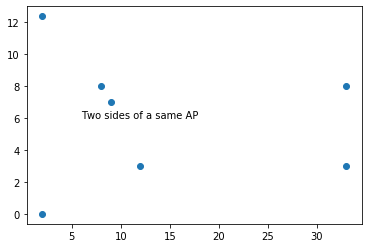

In [17]:
plt.scatter(ap_estimation['pos_x'], ap_estimation['pos_y'])
plt.annotate('Two sides of a same AP', xy=(6,6))
plt.show()

In [18]:
# The book provides the actual coordinates of 6 APs. We manually match them to APs, but add the same coordinate 7.5-6.3 to the top two AP MAC addresses. 
temp = pd.DataFrame({'ap_x':[7.5, 7.5, 1.0, 2.5, 33.5, 33.5, 12.8], 'ap_y':[6.3, 6.3, 14.0, -.8, 2.8, 9.3, -2.8]})
ap_estimation = pd.concat([ap_estimation['mac'], temp], axis=1)

In [19]:
ap_estimation

,mac,ap_x,ap_y
0,00:0f:a3:39:dd:cd,7.5,6.3
1,00:0f:a3:39:e1:c0,7.5,6.3
2,00:14:bf:3b:c7:c6,1.0,14.0
3,00:14:bf:b1:97:81,2.5,-0.8
4,00:14:bf:b1:97:8a,33.5,2.8
5,00:14:bf:b1:97:8d,33.5,9.3
6,00:14:bf:b1:97:90,12.8,-2.8


In [34]:
offline.to_csv('./data/offline_processed2.csv', index=None)

My plan is creating a  plot that shows relationship between distance and signal strenth. I will skip it for the moment, but come back later 

### Pivoting offline dataframe for KNN prediction 
As the offline dataframe contains 900k+ records, the KNN prediction can take long. So we will choose specific range of angles(orientations) as a method of sampling. Let's apply 45 to 135 degree group.

In [28]:
# Initially, we selected 90, 135, 180 ranges (5/15 version)
offline_pivot = offline[offline['orientation'].isin([90.0, 135.0, 180.0])].reset_index(drop=True)

# We will take another route. (5/16 version per Lance)
# Random sampling of angles, but balanced shuffling. 
#from sklearn.model_selection import train_test_split
#stratified_offline_sample, _ = train_test_split(offline, test_size=0.8, stratify=offline['orientation'], random_state=42)
#offline_pivot = stratified_offline_sample

offline_pivot['pos_xy'] = offline_pivot[['pos_x', 'pos_y']].astype(str).agg('-'.join, axis=1)

# it seems that we got balanced samples per each location
offline_pivot['pos_xy'].value_counts()

32.0-7.0    1187
5.0-7.0     1160
12.0-5.0    1158
29.0-3.0    1156
2.0-13.0    1153
            ... 
16.0-3.0    1011
14.0-8.0    1008
16.0-8.0     999
14.0-7.0     994
20.0-8.0     982
Name: pos_xy, Length: 166, dtype: int64

In [29]:
offline_pivot = pd.pivot_table(offline_pivot, values='signal', index='pos_xy', columns='mac', aggfunc=np.mean).reset_index()

In [30]:
offline_pivot.head()

mac,pos_xy,00:0f:a3:39:dd:cd,00:0f:a3:39:e1:c0,00:14:bf:3b:c7:c6,00:14:bf:b1:97:81,00:14:bf:b1:97:8a,00:14:bf:b1:97:8d,00:14:bf:b1:97:90
0,0.0-0.0,-69.631868,-53.364198,-66.689189,-64.946565,-38.576923,-65.709220,-56.469388
1,0.0-1.0,-71.142857,-53.126374,-65.925926,-65.877551,-39.577381,-65.511111,-58.237179
2,0.0-10.0,-68.704301,-55.108571,-65.131944,-66.724409,-46.041667,-65.698529,-52.006849
3,0.0-11.0,-70.396648,-54.341969,-67.896296,-68.302158,-47.691860,-66.900000,-55.430464
4,0.0-12.0,-68.433155,-54.164103,-67.826087,-70.777778,-45.937500,-68.429688,-53.424658


In [32]:
# save the file for prediction
offline_pivot.to_csv('./data/offline_pivot.csv', index=False)